# Symmetric vs asymmetric parcellation


In [3]:
import sys
sys.path.append("..")
import ProbabilisticParcellation.evaluate as ev
import ProbabilisticParcellation.util as ut
import ProbabilisticParcellation.export_atlas as ea
import ProbabilisticParcellation.scripts.atlas_paper.parcel_hierarchy as ph
import ProbabilisticParcellation.scripts.atlas_paper.evaluate_atlas as eva
from Functional_Fusion.dataset import *
import matplotlib
import matplotlib.pyplot as plt
import seaborn as sb
import pandas as pd


# Flatmap of symmetric vs asymmetric parcellation
Asymmetric parcellation was generated by freezing the emission models of the symmetric 68 parcellation and fitting an asymmetric arrangement model

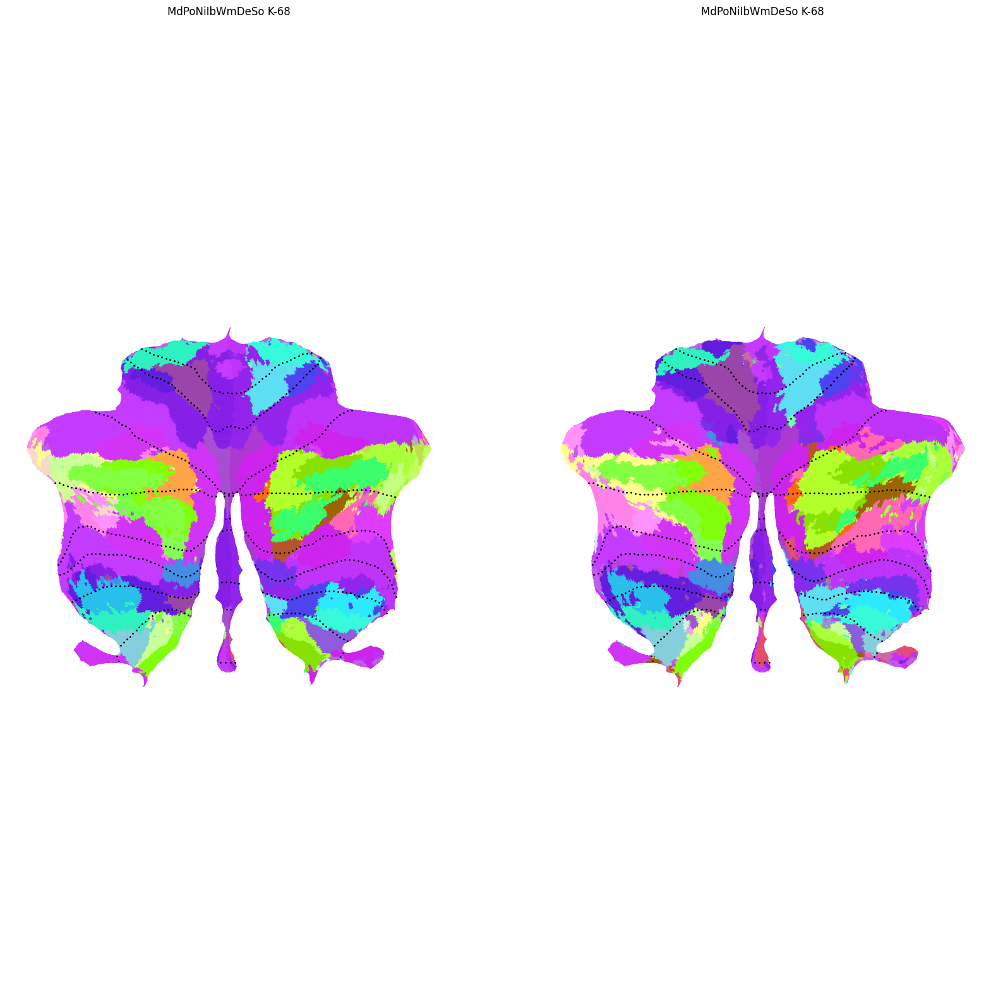

In [13]:
figsize=(20,20)
lut_dir = '/Volumes/diedrichsen_data$/data/Cerebellum/ProbabilisticParcellationModel/Atlases/'
_, cmap, labels = nt.read_lut(lut_dir +
                              'sym_MdPoNiIbWmDeSo_space-MNISymC2_K-68.lut')
models = [
          'Models_03/sym_MdPoNiIbWmDeSo_space-MNISymC2_K-68',
          'Models_03/asym_MdPoNiIbWmDeSo_space-MNISymC2_K-68_arrange-asym']

plt.figure(figsize=figsize)
ut.plot_model_parcel(models, [1,2],  cmap=cmap,align=True)

# Clustered parcellation
At K=32, medium level, clustered using assignment

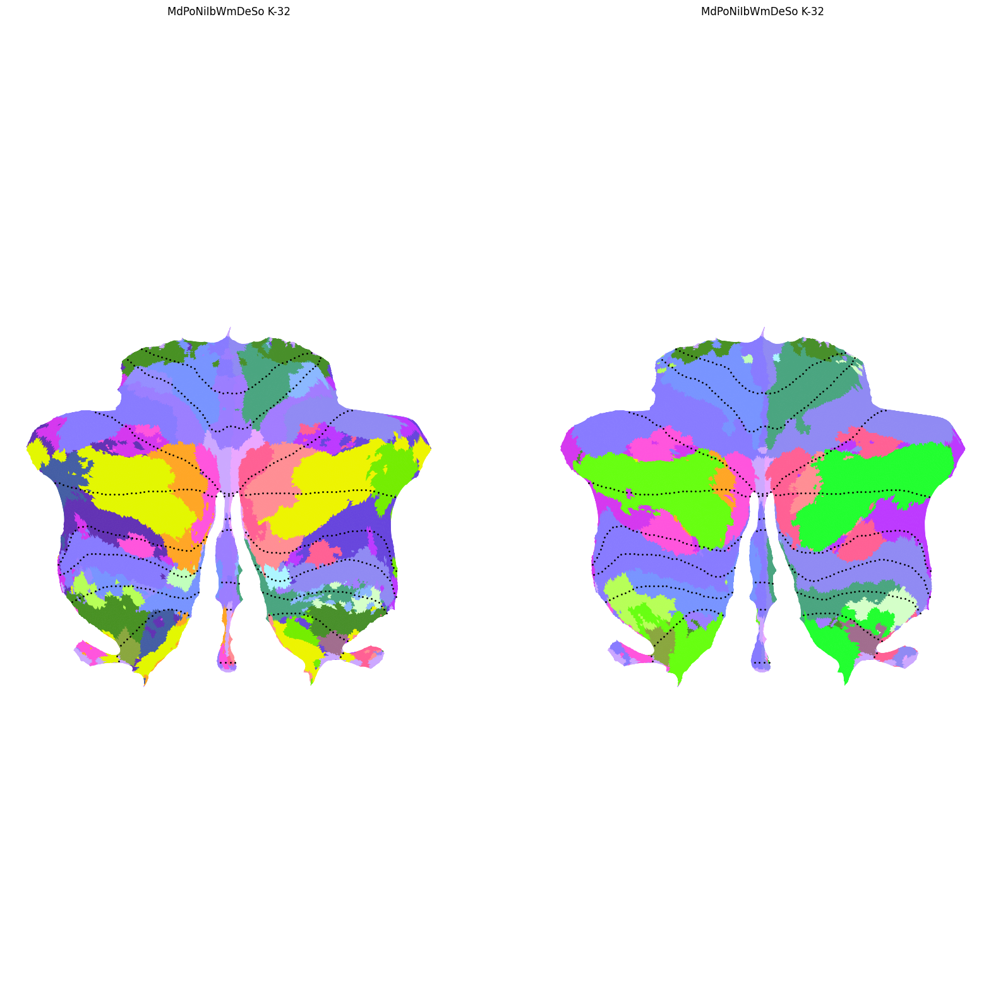

In [13]:
figsize=(20,20)
lut_dir = '/Volumes/diedrichsen_data$/data/Cerebellum/ProbabilisticParcellationModel/Atlases/'
_, cmap, labels = nt.read_lut(lut_dir +
                              'sym_MdPoNiIbWmDeSo_space-MNISymC3_K-32_meth-mixed.lut')
models = [
          'Models_03/sym_MdPoNiIbWmDeSo_space-MNISymC3_K-32_meth-mixed',
          'Models_03/sym_MdPoNiIbWmDeSo_space-MNISymC3_K-32']

plt.figure(figsize=figsize)
ut.plot_model_parcel(models, [1,2],  cmap=cmap,align=True)

<Figure size 3000x2000 with 0 Axes>

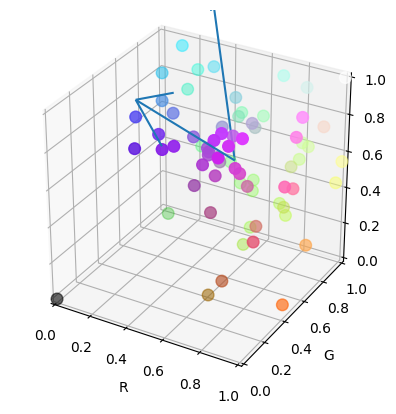

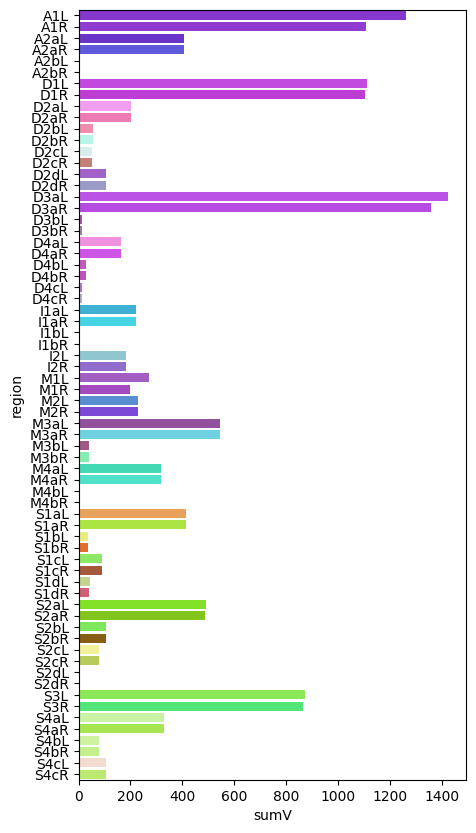

<Figure size 3000x2000 with 0 Axes>

In [14]:
figsize = (30, 20)
_, cmap, labels = nt.read_lut(lut_dir +
                              'sym_MdPoNiIbWmDeSo_space-MNISymC2_K-68_reordered.lut')
Prob, parcel, atlas, labels, cmap = ea.colour_parcel(mname='Models_03/sym_MdPoNiIbWmDeSo_space-MNISymC2_K-68_reordered', labels=labels)
plt.figure(figsize=figsize)


In [15]:
print(labels)

['0', 'M1L', 'M2L', 'M3aL', 'M3bL', 'M4aL', 'M4bL', 'A1L', 'A2aL', 'A2bL', 'D1L', 'D2aL', 'D2bL', 'D2cL', 'D2dL', 'D3aL', 'D3bL', 'D4aL', 'D4bL', 'D4cL', 'I1aL', 'I1bL', 'I2L', 'S1aL', 'S1bL', 'S1cL', 'S1dL', 'S2aL', 'S2bL', 'S2cL', 'S2dL', 'S3L', 'S4aL', 'S4bL', 'S4cL', 'M1R', 'M2R', 'M3aR', 'M3bR', 'M4aR', 'M4bR', 'A1R', 'A2aR', 'A2bR', 'D1R', 'D2aR', 'D2bR', 'D2cR', 'D2dR', 'D3aR', 'D3bR', 'D4aR', 'D4bR', 'D4cR', 'I1aR', 'I1bR', 'I2R', 'S1aR', 'S1bR', 'S1cR', 'S1dR', 'S2aR', 'S2bR', 'S2cR', 'S2dR', 'S3R', 'S4aR', 'S4bR', 'S4cR']


<Figure size 3000x2000 with 0 Axes>

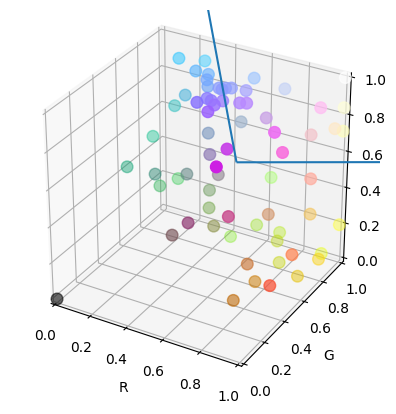

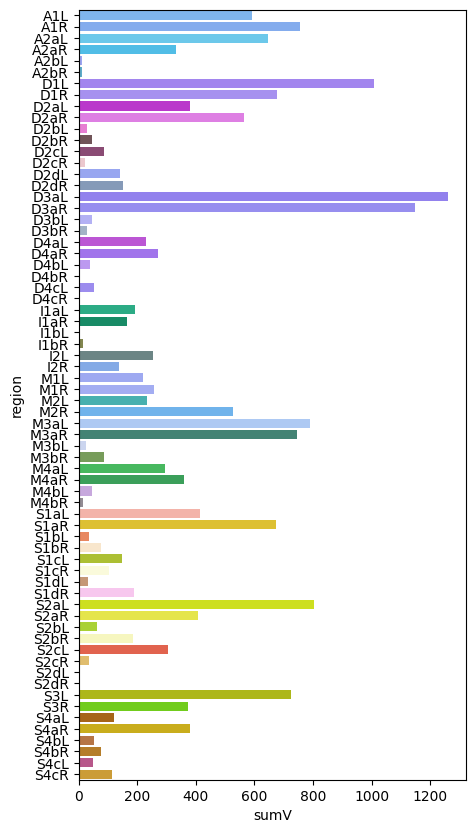

<Figure size 3000x2000 with 0 Axes>

In [7]:
figsize = (30, 20)
Prob, parcel, atlas, labels, cmap = ea.colour_parcel(
    'Models_03/asym_MdPoNiIbWmDeSo_space-MNISymC2_K-68_arrange-asym_reordered', labels=labels)
plt.figure(figsize=figsize)


# Comparing asym with sym
Using ARI and voxel matching

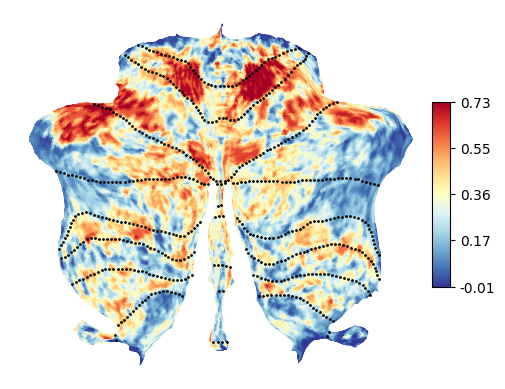

Text(0.5, 1.0, 'Adjusted Rand Index')

In [2]:
# --- ARI ---
# Compute adjusted rand index of each voxel
ari, ax = eva.compare_voxelwise('Models_03/sym_MdPoNiIbWmDeSo_space-MNISymC2_K-68_reordered',
                               'Models_03/asym_MdPoNiIbWmDeSo_space-MNISymC2_K-68_arrange-asym_reordered', plot=True, method='ari')

ax.set_title('Adjusted Rand Index')




In [3]:
print(f'ARI range: {ari.min()} - {ari.max()}')


ARI range: -0.06843094527721405 - 0.7919145226478577


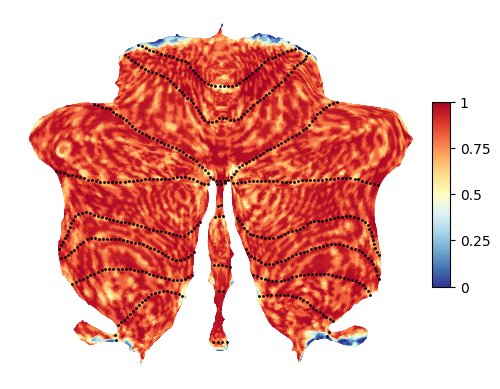

Text(0.5, 1.0, 'Rand Index')

In [2]:
ri, ax = eva.compare_voxelwise('Models_03/sym_MdPoNiIbWmDeSo_space-MNISymC2_K-68_reordered',
                            'Models_03/asym_MdPoNiIbWmDeSo_space-MNISymC2_K-68_arrange-asym_reordered', plot=True, method='ri', lim = (0,1))
ax.set_title('Rand Index')


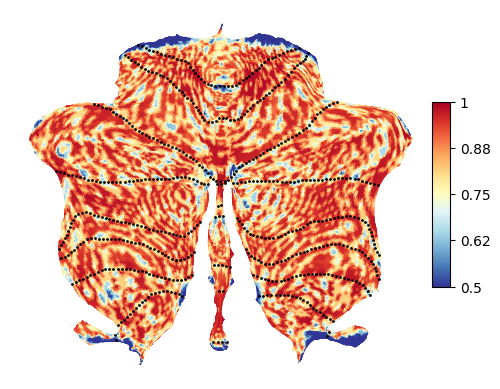

In [9]:

plt.figure()
ax = ut.plot_data_flat(ri, 'MNISymC2',
                       dtype='func',
                       render='matplotlib',
                       cmap='RdYlBu_r',
                       cscale=[0.5, 1],
                       colorbar=True)
plt.show()


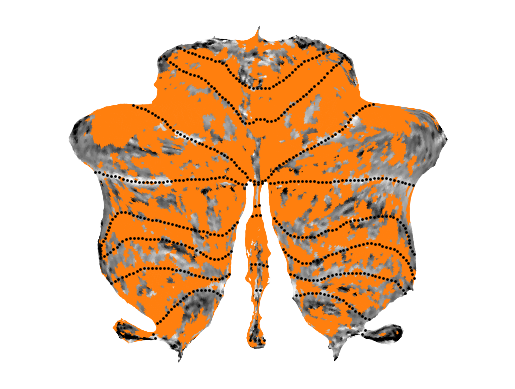

Text(0.5, 1.0, 'Match')

In [5]:
# --- Match ---
# Compute how many voxels land in the same parcel

match, ax = eva.compare_voxelwise('Models_03/sym_MdPoNiIbWmDeSo_space-MNISymC2_K-68_reordered',
                                   'Models_03/asym_MdPoNiIbWmDeSo_space-MNISymC2_K-68_arrange-asym_reordered', plot=True, method='match')
ax.set_title('Match')


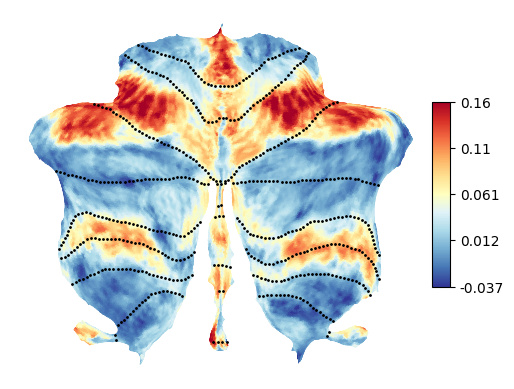

Text(0.5, 1.0, 'Correlation')

In [5]:
corr, ax = eva.compare_voxelwise('Models_03/sym_MdPoNiIbWmDeSo_space-MNISymC2_K-68_reordered',
                            'Models_03/asym_MdPoNiIbWmDeSo_space-MNISymC2_K-68_arrange-asym_reordered', plot=True, method='corr')
ax.set_title('Correlation')


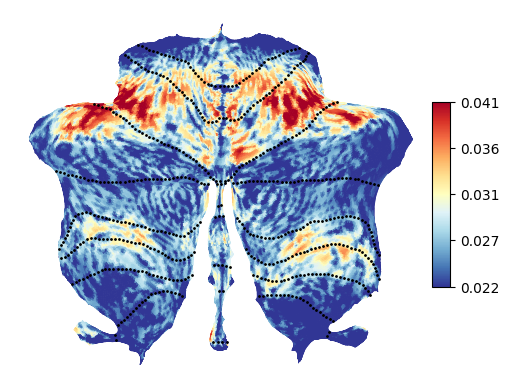

Text(0.5, 1.0, 'Cosine Angle')

In [3]:
cosang, ax = eva.compare_voxelwise('Models_03/sym_MdPoNiIbWmDeSo_space-MNISymC2_K-68_reordered',
                            'Models_03/asym_MdPoNiIbWmDeSo_space-MNISymC2_K-68_arrange-asym_reordered', plot=True, method='cosang')
ax.set_title('Cosine Angle')


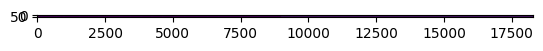

In [4]:


mname1 = 'Models_03/sym_MdPoNiIbWmDeSo_space-MNISymC2_K-68_reordered'
mname2 = 'Models_03/asym_MdPoNiIbWmDeSo_space-MNISymC2_K-68_arrange-asym_reordered'

# load models
info_a, model_a = ut.load_batch_best(mname1)
_, model_b = ut.load_batch_best(mname2)

prob_a = model_a.arrange.marginal_prob()
prob_b = model_b.arrange.marginal_prob()

atlas = info_a.atlas
suit_atlas, _ = am.get_atlas(atlas, ut.base_dir + '/Atlases')



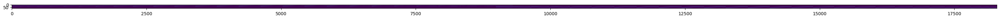

In [6]:
plt.figure(figsize=(40, 20))
plt.imshow(prob_a)


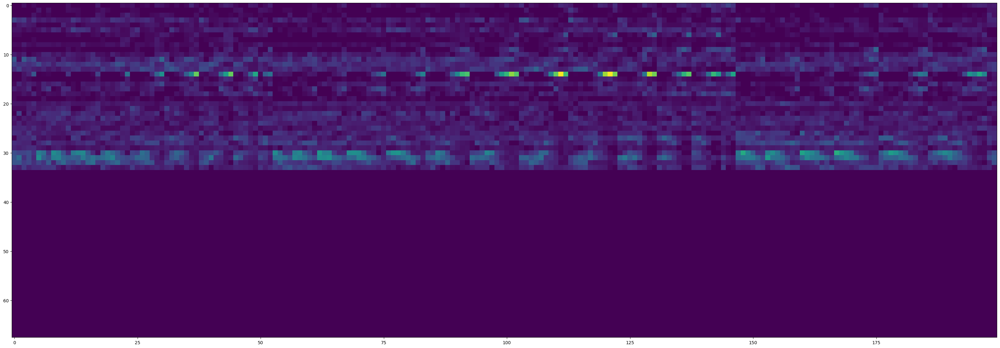

In [7]:
plt.figure(figsize=(40, 20))
# Plot left half
plt.imshow(prob_a[:, :200])


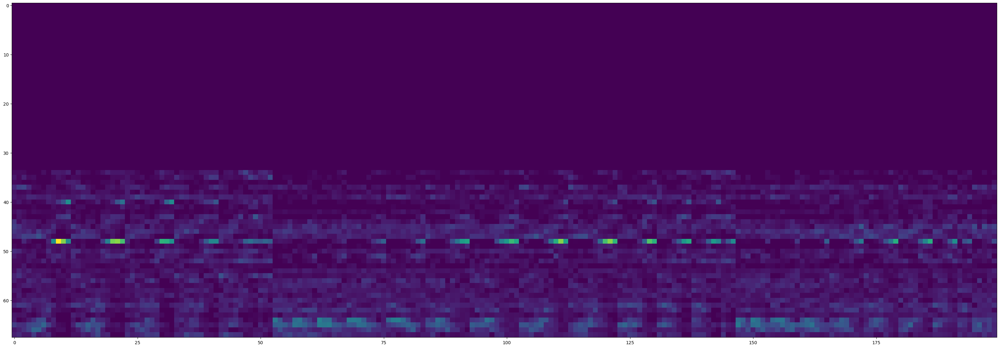

In [8]:
plt.figure(figsize=(40, 20))
# Plot left half
plt.imshow(prob_a[:, -200:])


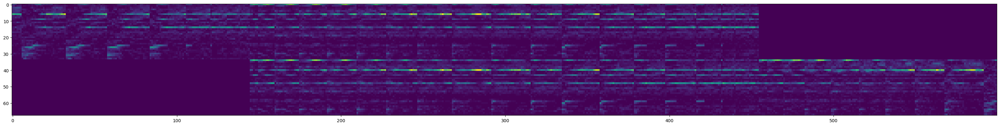

In [13]:
# Plot middle
plt.figure(figsize=(40, 20))
plt.imshow(prob_a[:, prob_a.shape[1]//2-300:prob_a.shape[1]//2+300])

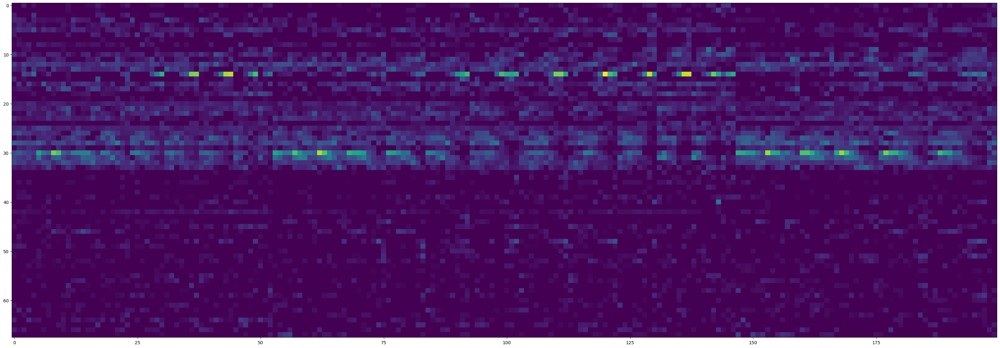

In [9]:
plt.figure(figsize=(40, 20))
# Plot left half
plt.imshow(prob_b[:, :200])


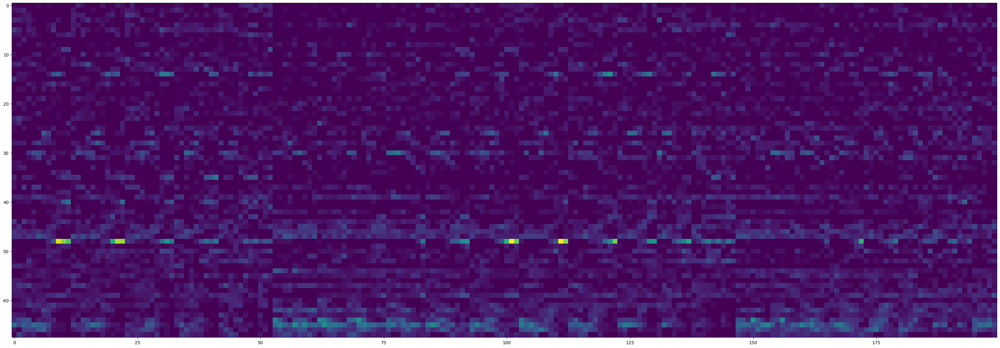

In [10]:
plt.figure(figsize=(40, 20))
# Plot left half
plt.imshow(prob_b[:, -200:])
